In [1]:
import xarray as xr
import geopandas as gpd
import pandas as pd
import numpy as np
import shapely.geometry
import shapely
from shapely import wkt
import rasterio
from rasterio import features
import rioxarray
from rasterio.features import shapes
from rasterio.enums import MergeAlg
from rasterio.plot import show
from numpy import int16
from shapely.geometry import shape
import matplotlib.pyplot as plt
from pathlib import Path
import shapely.plotting
from shapely.geometry import Polygon

import shapely.wkt
import shapely.geometry

len wind =  6327
len Solar =  28765


<Axes: >

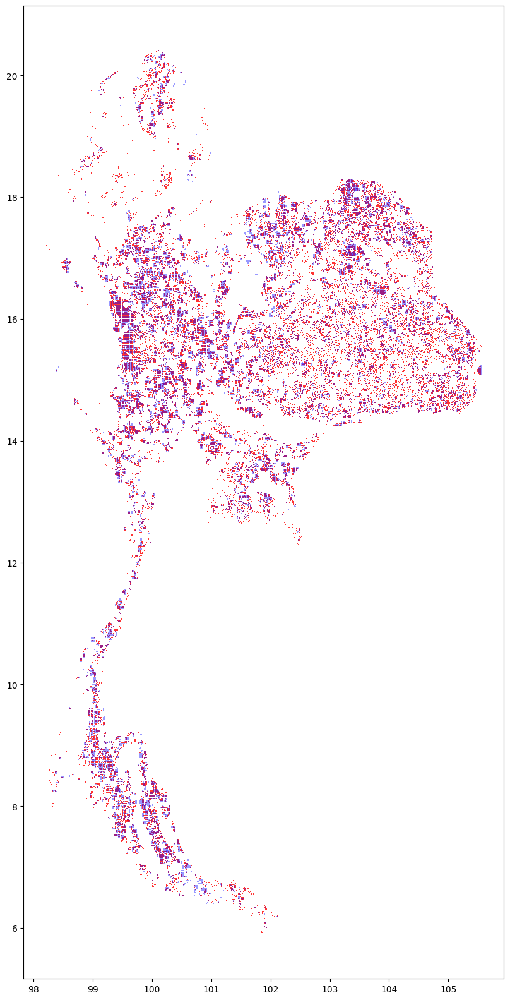

In [2]:
df_final_SI_Wind = pd.read_csv('Output_SolarWind\\df_final_SI_Wind.csv')
df_final_SI_Solar = pd.read_csv('Output_SolarWind\\df_final_SI_Solar.csv')
df_final_SI_Wind['geometry'] = df_final_SI_Wind['geometry'].apply(wkt.loads)
df_final_SI_Solar['geometry'] = df_final_SI_Solar['geometry'].apply(wkt.loads)
gdp_final_SI_Wind = gpd.GeoDataFrame(df_final_SI_Wind, crs='epsg:4326')
gdp_final_SI_Solar = gpd.GeoDataFrame(df_final_SI_Solar, crs='epsg:4326')

gdp_final_SI_Wind = gdp_final_SI_Wind.drop(columns=['raster_val','center'])
gdp_final_SI_Solar = gdp_final_SI_Solar.drop(columns=['raster_val','center'])

print("len wind = ",len(gdp_final_SI_Wind))
print("len Solar = ",len(gdp_final_SI_Solar))

fig, ax = plt.subplots(figsize=(20,20))
gdp_final_SI_Solar.geometry.plot(ax = ax, color='red',alpha = 0.8,zorder = 0)
gdp_final_SI_Wind.geometry.plot(ax = ax, color='blue',alpha = 0.4,zorder = 1)

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


<Axes: >

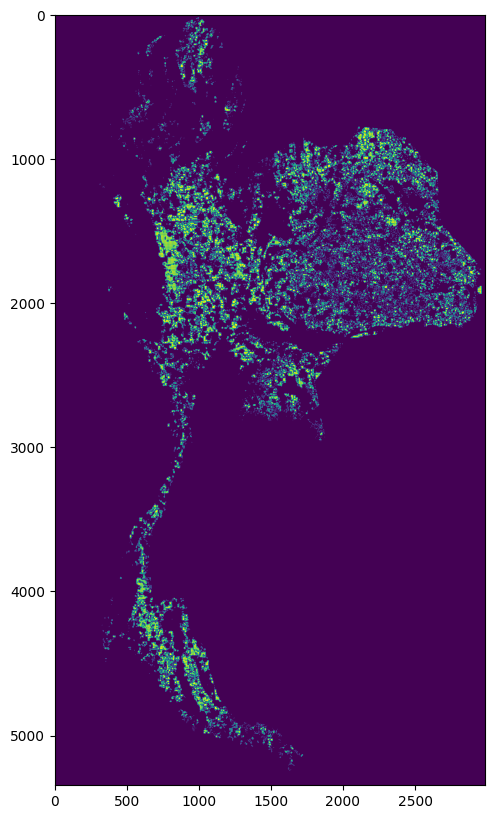

In [3]:
xr_rasterized_wind = rasterio.open('Output_SolarWind\\xr_AVA_Wind.nc')
geom = [shapes for shapes in gdp_final_SI_Wind.geometry]

rasterized_wind = features.rasterize(geom,
                                out_shape = xr_rasterized_wind.shape,
                                fill = 0,
                                out = None,
                                transform = xr_rasterized_wind.transform,
                                all_touched = True,
                                default_value = 1,
                                dtype = None)

xr_rasterized_solar = rasterio.open('Output_SolarWind\\xr_AVA_solar.nc')
geom = [shapes for shapes in gdp_final_SI_Solar.geometry]

rasterized_solar = features.rasterize(geom,
                                out_shape = xr_rasterized_solar.shape,
                                fill = 0,
                                out = None,
                                transform = xr_rasterized_solar.transform,
                                all_touched = True,
                                default_value = 1,
                                dtype = None)


rasterized = rasterized_wind+rasterized_solar
print(rasterized)
# Plot raster
fig, ax = plt.subplots(1, figsize = (10, 10))
show(rasterized, ax = ax)
plt.gca()

<xarray.Dataset>
Dimensions:  (lat: 5346, lon: 2985)
Coordinates:
  * lat      (lat) float64 5.615 5.618 5.621 5.624 ... 20.45 20.46 20.46 20.46
  * lon      (lon) float64 97.35 97.35 97.35 97.35 ... 105.6 105.6 105.6 105.6
Data variables:
    v        (lat, lon) int32 0 0 0 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0 0 0 0


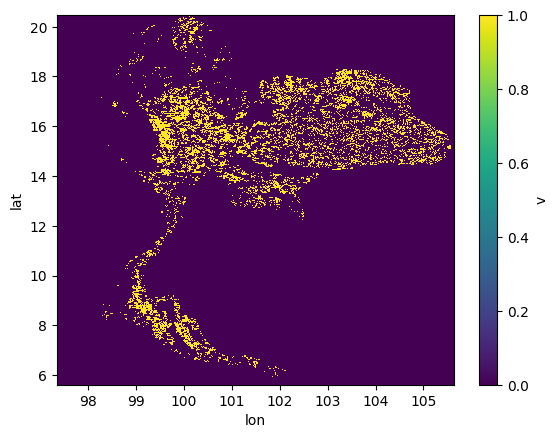

In [4]:
xr_format= xr.open_dataset('Output_SolarWind\\xr_AVA_Wind.nc')
lat = list(xr_format.lat)
lon = list(xr_format.lon)

rasterized_i = rasterized[::-1]

r = xr.DataArray(
    data = rasterized_i,
    coords = dict(
        lat = ('lat',lat),
        lon = ('lon',lon),

    )
)

xr_r = r.to_dataset(name="v")
xr_r['v'] = xr.where( (xr_r['v'] > 0),1,0)
xr_r.to_netcdf(path='Output_SolarWind\\xr_rasterized_largepolygon.nc')
print(xr_r)
xr_r['v'].plot()

In [5]:
mask = None
with rasterio.Env():
    with rasterio.open('Output_SolarWind\\xr_rasterized_largepolygon.nc') as src:
        image = src.read(1) # first band
        results = (
        {'properties': {'raster_val': v}, 'geometry': s}
        for i, (s, v) 
        in enumerate(
            shapes(image, mask=mask, transform=src.transform)))

geoms = list(results)

gpd_polygonized_raster  = gpd.GeoDataFrame.from_features(geoms)
gpd_polygonized_raster.crs = {'init': 'epsg:4326'}
gpd_polygonized_raster= gpd_polygonized_raster.to_crs({'init': 'epsg:3857'})
gpd_polygonized_raster['area'] = gpd_polygonized_raster['geometry'].area / (10**6)
gpd_polygonized_raster['area'] = round(gpd_polygonized_raster['area'],4)
gpd_polygonized_raster = gpd_polygonized_raster.to_crs({'init': 'epsg:4326'})
gpd_polygonized_raster = gpd_polygonized_raster.loc[gpd_polygonized_raster['raster_val'] == 1]
gpd_polygonized_raster.reset_index(inplace=True,drop=True)
gpd_polygonized_raster.reset_index(inplace=True)
gpd_polygonized_raster = gpd_polygonized_raster.rename(columns = {'index' : 'pol_id'})

print(gpd_polygonized_raster)

c:\Users\EGAT\AppData\Local\Programs\Python\Python311\Lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
c:\Users\EGAT\AppData\Local\Programs\Python\Python311\Lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


       pol_id                                           geometry  raster_val  \
0           0  POLYGON ((100.10833 20.41667, 100.11944 20.416...         1.0   
1           1  POLYGON ((100.07500 20.40278, 100.08333 20.402...         1.0   
2           2  POLYGON ((99.97222 20.36944, 99.97222 20.34167...         1.0   
3           3  POLYGON ((100.10833 20.37500, 100.11111 20.375...         1.0   
4           4  POLYGON ((99.95833 20.35556, 99.96111 20.35556...         1.0   
...       ...                                                ...         ...   
15761   15761  POLYGON ((101.83611 5.93056, 101.83611 5.92778...         1.0   
15762   15762  POLYGON ((101.89722 5.91944, 101.89722 5.91667...         1.0   
15763   15763  POLYGON ((101.83889 5.92778, 101.83889 5.91944...         1.0   
15764   15764  POLYGON ((101.89167 5.91667, 101.89722 5.91667...         1.0   
15765   15765  POLYGON ((101.87500 5.90833, 101.87778 5.90833...         1.0   

         area  
0      4.9990  
1      

In [6]:
df_final_SI_Wind = pd.read_csv('Output_SolarWind\\df_final_SI_Wind.csv')
df_final_SI_Solar = pd.read_csv('Output_SolarWind\\df_final_SI_Solar.csv')
df_final_SI_Wind['area'] = round(df_final_SI_Wind['area'],4)
df_final_SI_Solar['area'] = round(df_final_SI_Solar['area'],4)

df_final_SI_Wind['geometry'] = df_final_SI_Wind['geometry'].apply(wkt.loads)
df_final_SI_Solar['geometry'] = df_final_SI_Solar['geometry'].apply(wkt.loads)
gdp_final_SI_Wind = gpd.GeoDataFrame(df_final_SI_Wind, crs='epsg:4326')
gdp_final_SI_Solar = gpd.GeoDataFrame(df_final_SI_Solar, crs='epsg:4326')
gdp_final_SI_Wind = gdp_final_SI_Wind.set_geometry(gdp_final_SI_Wind['geometry'])
gdp_final_SI_Solar = gdp_final_SI_Solar.set_geometry(gdp_final_SI_Solar['geometry'])

gdp_final_SI_Wind.reset_index(inplace=True,drop=True)
gdp_final_SI_Solar.reset_index(inplace=True,drop=True)

print(gdp_final_SI_Wind)
print(gdp_final_SI_Solar)

      pol_id_wind                                           geometry  \
0               0  POLYGON ((100.10833 20.41667, 100.11944 20.416...   
1               1  POLYGON ((99.99167 20.36944, 99.99444 20.36944...   
2               2  POLYGON ((99.99167 20.33611, 99.99444 20.33611...   
3               3  POLYGON ((99.89167 20.31944, 99.90556 20.31944...   
4               4  POLYGON ((100.03611 20.34167, 100.05000 20.341...   
...           ...                                                ...   
6322         6322  POLYGON ((100.70498 6.60220, 100.70498 6.63484...   
6323         6323  POLYGON ((100.70498 6.67627, 100.70498 6.70891...   
6324         6324  POLYGON ((100.73739 6.63924, 100.73739 6.67187...   
6325         6325  POLYGON ((100.73739 6.67627, 100.73739 6.70891...   
6326         6326  POLYGON ((101.44664 6.48276, 101.44664 6.51724...   

      raster_val     area                                         center  \
0              3   5.1010  POINT (100.09849999999997 20.405

In [7]:
gpd_polygonized_raster['from_pol_id_wind'] = 0
gpd_polygonized_raster['list_pol_id_wind'] = None
gpd_polygonized_raster['SI_Wind'] = 0
gpd_polygonized_raster['area_wind'] = 0
gpd_polygonized_raster['coord_wind'] = 0

gpd_polygonized_raster['from_pol_id_solar'] = 0
gpd_polygonized_raster['list_pol_id_solar'] = None
gpd_polygonized_raster['SI_Solar'] = 0
gpd_polygonized_raster['area_solar'] = 0
gpd_polygonized_raster['coord_solar'] = 0

for i , pol in enumerate(gpd_polygonized_raster['geometry']):
    ##################################### WINNNDD ###########################################################################################################
    gpd_polygonized_raster['from_pol_id_wind'][i] = gdp_final_SI_Wind['pol_id_wind'].loc[gdp_final_SI_Wind['geometry'].within(pol)].count()
    if(gpd_polygonized_raster['from_pol_id_wind'][i] > 1 ):
        # gpd_polygonized_raster['list_pol_id_wind'][i] = [id for id in gdp_final_SI_Wind['pol_id_wind'].loc[gdp_final_SI_Wind['geometry'].within(pol)].values]
        # print(gdp_final_SI_Wind['pol_id_wind'].loc[gdp_final_SI_Wind['geometry'].within(pol)].values)
        gpd_polygonized_raster['list_pol_id_wind'][i] = gdp_final_SI_Wind['pol_id_wind'].loc[gdp_final_SI_Wind['geometry'].within(pol)].values
        buffer = [poly for poly in (gdp_final_SI_Wind['geometry'].loc[gdp_final_SI_Wind['geometry'].within(pol)])]
        gpd_polygonized_raster['coord_wind'][i] = shapely.geometry.MultiPolygon(buffer)
        gpd_polygonized_raster['SI_Wind'][i] = gdp_final_SI_Wind['final_SI_Wind'].loc[gdp_final_SI_Wind['geometry'].within(pol)].mean() 
        # print("wind = ",gpd_polygonized_raster['from_pol_wind_id'][i],gpd_polygonized_raster['wind_area_coord'][i])
    else:
        if(gpd_polygonized_raster['from_pol_id_wind'][i] == 1 ):
            gpd_polygonized_raster['list_pol_id_wind'][i] = gdp_final_SI_Wind['pol_id_wind'].loc[gdp_final_SI_Wind['geometry'].within(pol)].values
            buffer = gdp_final_SI_Wind['geometry'].loc[gdp_final_SI_Wind['geometry'].within(pol)]
            buffer = buffer.reset_index()
            gpd_polygonized_raster['coord_wind'][i] = buffer['geometry'][0]
            gpd_polygonized_raster['SI_Wind'][i] = gdp_final_SI_Wind['final_SI_Wind'].loc[gdp_final_SI_Wind['geometry'].within(pol)].mean() 
        else:
            gpd_polygonized_raster['list_pol_id_wind'][i] = None
            gpd_polygonized_raster['from_pol_id_wind'][i] = 0
            gpd_polygonized_raster['coord_wind'][i] = None
            gpd_polygonized_raster['SI_Wind'][i] = 0
    gpd_polygonized_raster['area_wind'][i] = (gdp_final_SI_Wind['area'].loc[gdp_final_SI_Wind['geometry'].within(pol)]).sum()
    ##################################### WINNNDD ###########################################################################################################

    ##################################### Solar ###########################################################################################################
    gpd_polygonized_raster['from_pol_id_solar'][i] = gdp_final_SI_Solar['pol_id_solar'].loc[gdp_final_SI_Solar['geometry'].within(pol)].count()
    if(gpd_polygonized_raster['from_pol_id_solar'][i] > 1 ):
        # gpd_polygonized_raster['list_pol_id_solar'][i] = [id for id in gdp_final_SI_Solar['pol_id_solar'].loc[gdp_final_SI_Solar['geometry'].within(pol)].values]
        # print(gdp_final_SI_Solar['pol_id_solar'].loc[gdp_final_SI_Solar['geometry'].within(pol)].values)
        gpd_polygonized_raster['list_pol_id_solar'][i] = gdp_final_SI_Solar['pol_id_solar'].loc[gdp_final_SI_Solar['geometry'].within(pol)].values
        buffer = [poly for poly in (gdp_final_SI_Solar['geometry'].loc[gdp_final_SI_Solar['geometry'].within(pol)])]
        gpd_polygonized_raster['coord_solar'][i] = shapely.geometry.MultiPolygon(buffer)
        gpd_polygonized_raster['SI_Solar'][i] = gdp_final_SI_Solar['final_SI_Solar'].loc[gdp_final_SI_Solar['geometry'].within(pol)].mean()   
        # print("solar = ",gpd_polygonized_raster['from_pol_solar_id'][i],gpd_polygonized_raster['solar_area_coord'][i])
    else:
        if(gpd_polygonized_raster['from_pol_id_solar'][i] == 1 ):
            gpd_polygonized_raster['list_pol_id_solar'][i] = gdp_final_SI_Solar['pol_id_solar'].loc[gdp_final_SI_Solar['geometry'].within(pol)].values
            buffer = gdp_final_SI_Solar['geometry'].loc[gdp_final_SI_Solar['geometry'].within(pol)]
            buffer = buffer.reset_index()
            gpd_polygonized_raster['coord_solar'][i] = buffer['geometry'][0]
            gpd_polygonized_raster['SI_Solar'][i] = gdp_final_SI_Solar['final_SI_Solar'].loc[gdp_final_SI_Solar['geometry'].within(pol)].mean()
        else:
            gpd_polygonized_raster['list_pol_id_solar'][i] = None
            gpd_polygonized_raster['from_pol_id_solar'][i] = 0
            gpd_polygonized_raster['coord_solar'][i] = None
            gpd_polygonized_raster['SI_Solar'][i] = 0
    gpd_polygonized_raster['area_solar'][i] = (gdp_final_SI_Solar['area'].loc[gdp_final_SI_Solar['geometry'].within(pol)]).sum()
    ##################################### Solar ###########################################################################################################
    
try:
    gpd_polygonized_raster = gpd_polygonized_raster.drop(columns='raster_val')
except:
    None
    
print(gpd_polygonized_raster)
gpd_polygonized_raster.to_csv('Output_SolarWind\\df_final_SI_combined_SolarWind.csv',index=False)

C:\Users\EGAT\AppData\Local\Temp\ipykernel_14080\2381424878.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  gpd_polygonized_raster['from_pol_id_wind'][i] = gdp_final_SI_Wind['pol_id_wind'].loc[gdp_final_SI_Wind['geometry'].within(pol)].count()
C:\Users\EGAT\AppData\Local\Temp\ipykernel_14080\2381424878.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  gpd_polygonized_raster['list_pol_id_wind'][i] = None
C:\Users\EGAT\AppData\Local\Temp\ipykernel_14080\2381424878.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas

C:\Users\EGAT\AppData\Local\Temp\ipykernel_14080\2381424878.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  gpd_polygonized_raster['from_pol_id_wind'][i] = gdp_final_SI_Wind['pol_id_wind'].loc[gdp_final_SI_Wind['geometry'].within(pol)].count()
C:\Users\EGAT\AppData\Local\Temp\ipykernel_14080\2381424878.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  gpd_polygonized_raster['list_pol_id_wind'][i] = None
C:\Users\EGAT\AppData\Local\Temp\ipykernel_14080\2381424878.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas

       pol_id                                           geometry    area  \
0           0  POLYGON ((100.10833 20.41667, 100.11944 20.416...  4.9990   
1           1  POLYGON ((100.07500 20.40278, 100.08333 20.402...  2.3463   
2           2  POLYGON ((99.97222 20.36944, 99.97222 20.34167...  9.1788   
3           3  POLYGON ((100.10833 20.37500, 100.11111 20.375...  2.5497   
4           4  POLYGON ((99.95833 20.35556, 99.96111 20.35556...  2.9574   
...       ...                                                ...     ...   
15761   15761  POLYGON ((101.83611 5.93056, 101.83611 5.92778...  0.0961   
15762   15762  POLYGON ((101.89722 5.91944, 101.89722 5.91667...  0.0961   
15763   15763  POLYGON ((101.83889 5.92778, 101.83889 5.91944...  2.1149   
15764   15764  POLYGON ((101.89167 5.91667, 101.89722 5.91667...  0.5768   
15765   15765  POLYGON ((101.87500 5.90833, 101.87778 5.90833...  1.5380   

       from_pol_id_wind list_pol_id_wind   SI_Wind  area_wind  \
0                     

In [8]:
region = pd.read_csv('Data\\Region.csv',index_col=False)
thailandmap = gpd.read_file('Data\\tha_admbnda_adm1_rtsd_20220121\\tha_admbnda_adm1_rtsd_20220121.shp')

thailandmap.crs = {'init': 'epsg:4326'}
list_region = []

count = 0
for i in thailandmap['ADM1_TH']:
    r = region['region'].loc[region['province'] == i]
    try : 
        # print(i,r.values[0])
        list_region.append(r.values[0])
    except :
        print(i,'xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx')
        list_region.append('xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx')       
    
thailandmap['region'] = list_region
thailandmap['center'] = thailandmap['geometry'].centroid
thailandmap = thailandmap.set_geometry('center')
thailandmap = thailandmap.drop(columns = 'geometry')

gpd_polygonized_raster['region'] = 'unk'
gpd_polygonized_raster['center'] = gpd_polygonized_raster['geometry'].centroid
gpd_polygonized_raster = gpd_polygonized_raster.set_geometry('center')


c:\Users\EGAT\AppData\Local\Programs\Python\Python311\Lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\EGAT\AppData\Local\Temp\ipykernel_14080\561258906.py:18: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  thailandmap['center'] = thailandmap['geometry'].centroid
C:\Users\EGAT\AppData\Local\Temp\ipykernel_14080\561258906.py:23: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gpd_polygonized_ra

In [9]:
gpd_polygonized_raster_2 = gpd.sjoin_nearest(gpd_polygonized_raster,thailandmap,how='left')
print(gpd_polygonized_raster_2)

c:\Users\EGAT\AppData\Local\Programs\Python\Python311\Lib\site-packages\geopandas\array.py:364: UserWarning: Geometry is in a geographic CRS. Results from 'sjoin_nearest' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  warnings.warn(


       pol_id                                           geometry    area  \
0           0  POLYGON ((100.10833 20.41667, 100.11944 20.416...  4.9990   
1           1  POLYGON ((100.07500 20.40278, 100.08333 20.402...  2.3463   
2           2  POLYGON ((99.97222 20.36944, 99.97222 20.34167...  9.1788   
3           3  POLYGON ((100.10833 20.37500, 100.11111 20.375...  2.5497   
4           4  POLYGON ((99.95833 20.35556, 99.96111 20.35556...  2.9574   
...       ...                                                ...     ...   
15761   15761  POLYGON ((101.83611 5.93056, 101.83611 5.92778...  0.0961   
15762   15762  POLYGON ((101.89722 5.91944, 101.89722 5.91667...  0.0961   
15763   15763  POLYGON ((101.83889 5.92778, 101.83889 5.91944...  2.1149   
15764   15764  POLYGON ((101.89167 5.91667, 101.89722 5.91667...  0.5768   
15765   15765  POLYGON ((101.87500 5.90833, 101.87778 5.90833...  1.5380   

       from_pol_id_wind list_pol_id_wind   SI_Wind  area_wind  \
0                     

In [10]:
print(gpd_polygonized_raster_2.columns)
gpd_polygonized_raster_2 = gpd_polygonized_raster_2.drop(columns=
                                                         ['index_right'
                                                          ,'Shape_Leng'
                                                          ,'Shape_Area'
                                                          ,'ADM1ALT2EN'
                                                          ,'ADM1_PCODE'
                                                          ,'ADM1_REF'
                                                          ,'ADM1ALT1EN'
                                                          ,'ADM1ALT2EN'
                                                          ,'ADM1ALT1TH'
                                                          ,'ADM1ALT2EN'
                                                          ,'ADM1ALT1TH'
                                                          ,'ADM1ALT2TH'
                                                          ,'ADM0_EN'
                                                          ,'ADM0_TH'
                                                          ,'ADM0_PCODE'
                                                          ,'date'
                                                          ,'validOn'
                                                          ,'validTo'
                                                          ,'center'
                                                          ])
print(gpd_polygonized_raster_2.columns)

Index(['pol_id', 'geometry', 'area', 'from_pol_id_wind', 'list_pol_id_wind',
       'SI_Wind', 'area_wind', 'coord_wind', 'from_pol_id_solar',
       'list_pol_id_solar', 'SI_Solar', 'area_solar', 'coord_solar',
       'region_left', 'center', 'index_right', 'Shape_Leng', 'Shape_Area',
       'ADM1_EN', 'ADM1_TH', 'ADM1_PCODE', 'ADM1_REF', 'ADM1ALT1EN',
       'ADM1ALT2EN', 'ADM1ALT1TH', 'ADM1ALT2TH', 'ADM0_EN', 'ADM0_TH',
       'ADM0_PCODE', 'date', 'validOn', 'validTo', 'region_right'],
      dtype='object')
Index(['pol_id', 'geometry', 'area', 'from_pol_id_wind', 'list_pol_id_wind',
       'SI_Wind', 'area_wind', 'coord_wind', 'from_pol_id_solar',
       'list_pol_id_solar', 'SI_Solar', 'area_solar', 'coord_solar',
       'region_left', 'ADM1_EN', 'ADM1_TH', 'region_right'],
      dtype='object')


In [11]:
gpd_polygonized_raster_2 = gpd_polygonized_raster_2.drop(columns = 'region_left')
gpd_polygonized_raster_2 = gpd_polygonized_raster_2.rename(columns= {'region_right':'region'})
gpd_polygonized_raster_2 = gpd_polygonized_raster_2.drop_duplicates('pol_id')
print(gpd_polygonized_raster_2)

       pol_id                                           geometry    area  \
0           0  POLYGON ((100.10833 20.41667, 100.11944 20.416...  4.9990   
1           1  POLYGON ((100.07500 20.40278, 100.08333 20.402...  2.3463   
2           2  POLYGON ((99.97222 20.36944, 99.97222 20.34167...  9.1788   
3           3  POLYGON ((100.10833 20.37500, 100.11111 20.375...  2.5497   
4           4  POLYGON ((99.95833 20.35556, 99.96111 20.35556...  2.9574   
...       ...                                                ...     ...   
15761   15761  POLYGON ((101.83611 5.93056, 101.83611 5.92778...  0.0961   
15762   15762  POLYGON ((101.89722 5.91944, 101.89722 5.91667...  0.0961   
15763   15763  POLYGON ((101.83889 5.92778, 101.83889 5.91944...  2.1149   
15764   15764  POLYGON ((101.89167 5.91667, 101.89722 5.91667...  0.5768   
15765   15765  POLYGON ((101.87500 5.90833, 101.87778 5.90833...  1.5380   

       from_pol_id_wind list_pol_id_wind   SI_Wind  area_wind  \
0                     

In [12]:
gpd_polygonized_raster_2.to_csv('Output_SolarWind\\df_final_SI_combined_SolarWind.csv',index=False,encoding="utf-8-sig")

In [13]:
df = pd.read_csv('Output_SolarWind\\df_final_SI_combined_SolarWind.csv')
df = df.drop(columns=[
    'geometry',
    'from_pol_id_wind',
    'coord_wind',
    'from_pol_id_solar',
    'coord_solar',
    'ADM1_EN',
    'ADM1_TH'
    ])

In [14]:
df = df.drop_duplicates('pol_id')
print(df)

       pol_id    area list_pol_id_wind   SI_Wind  area_wind list_pol_id_solar  \
0           0  4.9990              NaN  0.000000     0.0000               [0]   
1           1  2.3463              NaN  0.000000     0.0000               [1]   
2           2  9.1788              [1]  1.872087     5.0993           [11370]   
3           3  2.5497              NaN  0.000000     0.0000               [2]   
4           4  2.9574              NaN  0.000000     0.0000               [3]   
...       ...     ...              ...       ...        ...               ...   
15761   15761  0.0961              NaN  0.000000     0.0000               NaN   
15762   15762  0.0961              NaN  0.000000     0.0000               NaN   
15763   15763  2.1149              NaN  0.000000     0.0000               NaN   
15764   15764  0.5768              NaN  0.000000     0.0000               NaN   
15765   15765  1.5380              NaN  0.000000     0.0000           [11369]   

       SI_Solar  area_solar

In [15]:
df = df.reset_index(drop=True)
print(df)

       pol_id    area list_pol_id_wind   SI_Wind  area_wind list_pol_id_solar  \
0           0  4.9990              NaN  0.000000     0.0000               [0]   
1           1  2.3463              NaN  0.000000     0.0000               [1]   
2           2  9.1788              [1]  1.872087     5.0993           [11370]   
3           3  2.5497              NaN  0.000000     0.0000               [2]   
4           4  2.9574              NaN  0.000000     0.0000               [3]   
...       ...     ...              ...       ...        ...               ...   
15761   15761  0.0961              NaN  0.000000     0.0000               NaN   
15762   15762  0.0961              NaN  0.000000     0.0000               NaN   
15763   15763  2.1149              NaN  0.000000     0.0000               NaN   
15764   15764  0.5768              NaN  0.000000     0.0000               NaN   
15765   15765  1.5380              NaN  0.000000     0.0000           [11369]   

       SI_Solar  area_solar

In [16]:
try:
    df = df.set_index('pol_id')
except:
    None

try:
    xr = xr.Dataset.from_dataframe(df)
except:
    None

xr.to_netcdf(path='Output_SolarWind\\xr_final_SI_combined_SolarWind.nc')
print(xr)

<xarray.Dataset>
Dimensions:            (pol_id: 15766)
Coordinates:
  * pol_id             (pol_id) int64 0 1 2 3 4 ... 15762 15763 15764 15765
Data variables:
    area               (pol_id) float64 4.999 2.346 9.179 ... 2.115 0.5768 1.538
    list_pol_id_wind   (pol_id) object nan nan '[1]' nan nan ... nan nan nan nan
    SI_Wind            (pol_id) float64 0.0 0.0 1.872 0.0 ... 0.0 0.0 0.0 0.0
    area_wind          (pol_id) float64 0.0 0.0 5.099 0.0 ... 0.0 0.0 0.0 0.0
    list_pol_id_solar  (pol_id) object '[0]' '[1]' '[11370]' ... nan '[11369]'
    SI_Solar           (pol_id) float64 2.152 2.145 2.215 ... 0.0 0.0 2.332
    area_solar         (pol_id) float64 3.877 2.244 7.581 2.55 ... 0.0 0.0 1.538
    region             (pol_id) object 'R4' 'R4' 'R4' 'R4' ... 'R3' 'R3' 'R3'
